In [1]:
using Pkg, Revise
Pkg.activate("../.")
using StaticArrays
using LinearAlgebra
using IntervalSets

using BasicBSpline
using Plots; plotly()

  Activating project at `~/MEGA/EMAP/Julia_Tutorials`
┌ Warning: For saving to png with the `Plotly` backend `PlotlyBase` and `PlotlyKaleido` need to be installed.
│   err = ArgumentError("Package PlotlyBase not found in current path.\n- Run `import Pkg; Pkg.add(\"PlotlyBase\")` to install the PlotlyBase package.")
└ @ Plots /home/davibarreira/.julia/packages/Plots/Hxe7H/src/backends.jl:545


Plots.PlotlyBackend()

BSplineManifold{2, (2, 2), SVector{3, Int64}, Tuple{BSplineSpace{2, Int64}, BSplineSpace{2, Int64}}}((BSplineSpace{2, Int64}(KnotVector([-1, -1, -1, 1, 1, 1])), BSplineSpace{2, Int64}(KnotVector([-1, -1, -1, 1, 1, 1]))), SVector{3, Int64}[[-1, -1, 2] [-1, 0, 0] [-1, 1, 2]; [0, -1, 0] [0, 0, -2] [0, 1, 0]; [1, -1, 2] [1, 0, 0] [1, 1, 2]])

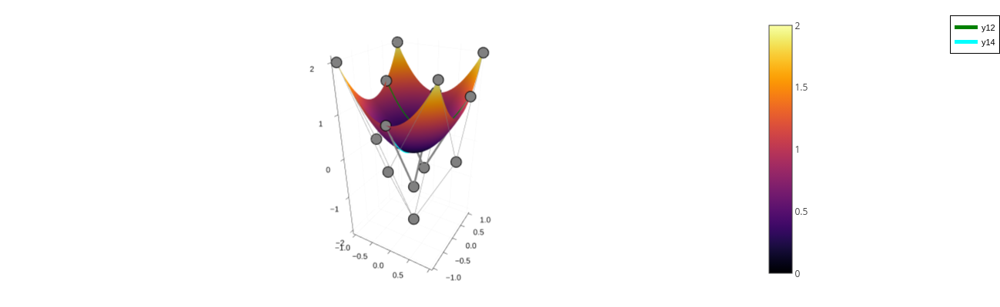

In [153]:
p = 2
k = KnotVector([-1,-1,-1,1,1,1])
P = BSplineSpace{p}(k)
a = [SVector(i,j,2i^2+2j^2-2) for i in -1:1, j in -1:1]
# a = [SVector(i,j, 0) for i in -1:1, j in -1:1]
M = BSplineManifold(a,P,P)
plot(M)

z = hcat(M.(t,t)...)
z = hcat(M(:,0.5).(0:0.1:1)...)
z = hcat(γ.(0:0.1:1)...)
# plot!(z[1,:],z[2,:],z[3,:], linewidth = 5, color=:cyan)
plot!(M(:,0.5), linewidth = 5, color=:green)
plot!(M(0.0,:), linewidth = 5, color=:cyan)

In [189]:

x = [0,0.5]
y = [0.0,-0.5]
h(t) = (1-t) * x + t*y
# curve(t) = (1-t)*M(0,0.5) + t*M(0.5,0)
# curve(t) = M(((1-t)*x)...) + M((t*y)...)

# curve(0.1)
# M(h[1],:)(1)
# M(:,y[2])(1)
γx(t) = M(h(t)[1],:)(t)[1]
γy(t) = M(:,h(t)[2])(t)[2]

γ(t)  = [γx(t) ,γy(t),0.25]

γ(0.5)
h(0.5)


M(:,h(0.5)[2])(0.5)
M(h(0.5)[1],:)(0.5)

3-element SVector{3, Float64} with indices SOneTo(3):
 0.0
 0.5
 0.25

In [40]:
M.controlpoints

3×3 Matrix{SVector{3, Int64}}:
 [-1, -1, 2]  [-1, 0, 0]  [-1, 1, 2]
 [0, -1, 0]   [0, 0, -2]  [0, 1, 0]
 [1, -1, 2]   [1, 0, 0]   [1, 1, 2]